#**Download dataset from Kaggle & Read dataset**

In [251]:
pip install opendatasets --upgrade

In [252]:
import opendatasets as od
import pandas as pd
import numpy as np

# Eric's Kaggle API key
# "username":"ericthedataguy",
# "key":"875c0de0faea2fefa081c78eb470a347"

od.download(
    "https://www.kaggle.com/datasets/jiashenliu/515k-hotel-reviews-data-in-europe")



Skipping, found downloaded files in "./515k-hotel-reviews-data-in-europe" (use force=True to force download)


In [253]:
df = pd.read_csv("515k-hotel-reviews-data-in-europe/Hotel_Reviews.csv")

Let's check for missing values

In [257]:
df.isnull().sum()

Hotel_Address                                    0
Additional_Number_of_Scoring                     0
Review_Date                                      0
Average_Score                                    0
Hotel_Name                                       0
Reviewer_Nationality                             0
Negative_Review                                  0
Review_Total_Negative_Word_Counts                0
Total_Number_of_Reviews                          0
Positive_Review                                  0
Review_Total_Positive_Word_Counts                0
Total_Number_of_Reviews_Reviewer_Has_Given       0
Reviewer_Score                                   0
Tags                                             0
days_since_review                                0
lat                                           3268
lng                                           3268
dtype: int64

We have some missing values for latitide and longitude. Since we have around 515k columns so we will just drop the rows.

In [258]:
df.dropna(inplace = True)

In [259]:
df.shape

(512470, 17)

Now, the shape of our dataset is aroundn 512k

In [260]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 512470 entries, 0 to 515737
Data columns (total 17 columns):
 #   Column                                      Non-Null Count   Dtype  
---  ------                                      --------------   -----  
 0   Hotel_Address                               512470 non-null  object 
 1   Additional_Number_of_Scoring                512470 non-null  int64  
 2   Review_Date                                 512470 non-null  object 
 3   Average_Score                               512470 non-null  float64
 4   Hotel_Name                                  512470 non-null  object 
 5   Reviewer_Nationality                        512470 non-null  object 
 6   Negative_Review                             512470 non-null  object 
 7   Review_Total_Negative_Word_Counts           512470 non-null  int64  
 8   Total_Number_of_Reviews                     512470 non-null  int64  
 9   Positive_Review                             512470 non-null  object 
 

Now, lets convert the review)date to its appropriate datatype

In [261]:
df['Review_Date'] = pd.to_datetime(df['Review_Date'])

In [262]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 512470 entries, 0 to 515737
Data columns (total 17 columns):
 #   Column                                      Non-Null Count   Dtype         
---  ------                                      --------------   -----         
 0   Hotel_Address                               512470 non-null  object        
 1   Additional_Number_of_Scoring                512470 non-null  int64         
 2   Review_Date                                 512470 non-null  datetime64[ns]
 3   Average_Score                               512470 non-null  float64       
 4   Hotel_Name                                  512470 non-null  object        
 5   Reviewer_Nationality                        512470 non-null  object        
 6   Negative_Review                             512470 non-null  object        
 7   Review_Total_Negative_Word_Counts           512470 non-null  int64         
 8   Total_Number_of_Reviews                     512470 non-null  int64        

In [263]:
df.head()

,Hotel_Address,Additional_Number_of_Scoring,Review_Date,Average_Score,Hotel_Name,Reviewer_Nationality,Negative_Review,Review_Total_Negative_Word_Counts,Total_Number_of_Reviews,Positive_Review,Review_Total_Positive_Word_Counts,Total_Number_of_Reviews_Reviewer_Has_Given,Reviewer_Score,Tags,days_since_review,lat,lng
0,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,2017-08-03,7.7,Hotel Arena,Russia,I am so angry that i made this post available...,397,1403,Only the park outside of the hotel was beauti...,11,7,2.9,"[' Leisure trip ', ' Couple ', ' Duplex Double...",0 days,52.360576,4.915968
1,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,2017-08-03,7.7,Hotel Arena,Ireland,No Negative,0,1403,No real complaints the hotel was great great ...,105,7,7.5,"[' Leisure trip ', ' Couple ', ' Duplex Double...",0 days,52.360576,4.915968
2,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,2017-07-31,7.7,Hotel Arena,Australia,Rooms are nice but for elderly a bit difficul...,42,1403,Location was good and staff were ok It is cut...,21,9,7.1,"[' Leisure trip ', ' Family with young childre...",3 days,52.360576,4.915968
3,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,2017-07-31,7.7,Hotel Arena,United Kingdom,My room was dirty and I was afraid to walk ba...,210,1403,Great location in nice surroundings the bar a...,26,1,3.8,"[' Leisure trip ', ' Solo traveler ', ' Duplex...",3 days,52.360576,4.915968
4,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,2017-07-24,7.7,Hotel Arena,New Zealand,You When I booked with your company on line y...,140,1403,Amazing location and building Romantic setting,8,3,6.7,"[' Leisure trip ', ' Couple ', ' Suite ', ' St...",10 days,52.360576,4.915968


we can see that the days_since_review column has unneccesarily has the word 'days'in it. So lets remove it and convert it into int type

In [265]:
df['days_since_review'] = df['days_since_review'].str.extract('(\d+)').astype(int)

In [266]:
# print(df['days_since_review'].unique())

In [267]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 512470 entries, 0 to 515737
Data columns (total 17 columns):
 #   Column                                      Non-Null Count   Dtype         
---  ------                                      --------------   -----         
 0   Hotel_Address                               512470 non-null  object        
 1   Additional_Number_of_Scoring                512470 non-null  int64         
 2   Review_Date                                 512470 non-null  datetime64[ns]
 3   Average_Score                               512470 non-null  float64       
 4   Hotel_Name                                  512470 non-null  object        
 5   Reviewer_Nationality                        512470 non-null  object        
 6   Negative_Review                             512470 non-null  object        
 7   Review_Total_Negative_Word_Counts           512470 non-null  int64         
 8   Total_Number_of_Reviews                     512470 non-null  int64        

In [268]:
# checking the unique number of Hotel_names with rating greater than 9
df[df['Average_Score'] > 9.0].Hotel_Name.nunique()

225

In [269]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

Now, let us just create a simple word cloud to see which words are more occuring for the postive and negative reviews

In [270]:
import random

In [271]:
# sampling only 10 rows of data
random.seed(1729)
df = df.sample(n = 10000)

In [272]:
df

,Hotel_Address,Additional_Number_of_Scoring,Review_Date,Average_Score,Hotel_Name,Reviewer_Nationality,Negative_Review,Review_Total_Negative_Word_Counts,Total_Number_of_Reviews,Positive_Review,Review_Total_Positive_Word_Counts,Total_Number_of_Reviews_Reviewer_Has_Given,Reviewer_Score,Tags,days_since_review,lat,lng
300354,Consell de Cent 498 500 Eixample 08013 Barcelo...,105,2016-07-23,8.3,Eurostars Monumental,United States of America,definitely not a 4 star it is a 3 star,12,1382,great location,3,1,6.7,"[' Leisure trip ', ' Family with older childre...",376,41.400665,2.178709
102936,202 rue de Rivoli 1st arr 75001 Paris France,297,2017-02-21,8.0,Saint James Albany Paris Hotel Spa,Belgium,Too many people at the pool and spa too noisy,11,2868,Amazing Location Great food Good bar Great Se...,13,7,9.2,"[' Leisure trip ', ' Couple ', ' Standard Room...",163,48.864269,2.330818
22243,10 Rue Kepler 16th arr 75016 Paris France,77,2016-05-12,9.1,H tel Keppler,Russia,No Negative,0,338,Very stylish elegant and comfortable Bed is c...,25,20,10.0,"[' Business trip ', ' Solo traveler ', ' Class...",448,48.869910,2.297339
495111,Viale Fulvio Testi 300 Bicocca Zara 20126 Mila...,108,2016-07-03,8.5,Starhotels Tourist,United Arab Emirates,Filtered my search for hotels with shuttle se...,61,2135,No Positive,0,4,3.8,"[' Leisure trip ', ' Solo traveler ', ' Classi...",396,45.526640,9.213155
120420,24 Ludgate Hill City of London London EC4M 7DR...,918,2016-08-11,8.4,Club Quarters Hotel St Paul s,United Kingdom,No Negative,0,4117,Service excellent and very accomodating when ...,23,6,10.0,"[' Leisure trip ', ' Family with older childre...",357,51.513930,-0.101126
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
441790,Scarsdale Place Kensington Kensington and Chel...,1831,2016-07-12,8.1,Copthorne Tara Hotel London Kensington,Ireland,I have stayed at this hotel several times but...,48,7105,The choice of breakfast was good Staff pleasa...,12,1,6.7,"[' Business trip ', ' Solo traveler ', ' Stand...",387,51.499046,-0.191707
378926,Matrosengasse 6 8 06 Mariahilf 1060 Vienna Aus...,387,2017-02-27,8.1,Leonardo Hotel Vienna,Romania,,2,6373,Friendly helpfull staff very good breakfast,8,2,7.9,"[' Leisure trip ', ' Family with young childre...",157,48.194530,16.340327
245748,8 10 Queensberry Place Kensington and Chelsea ...,388,2017-03-20,8.4,The Exhibitionist Hotel,Switzerland,Breakfast could have been included for the pe...,12,1708,Very friendly staff quite new and conremporar...,18,6,8.3,"[' Leisure trip ', ' Couple ', ' Superior Doub...",136,51.494775,-0.177789
437119,Royal Victoria Dock Western Gateway Newham Lon...,879,2016-07-07,8.8,Crowne Plaza London Docklands,United Kingdom,Shower in room could have been better,8,2768,Bed was very comfy and to in room was excellent,12,1,8.3,"[' Leisure trip ', ' Couple ', ' Queen Room ',...",392,51.508354,0.019886


In [273]:
# for positive reviews
positive_reviews = " ".join(df['Positive_Review'].dropna())
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(positive_reviews)

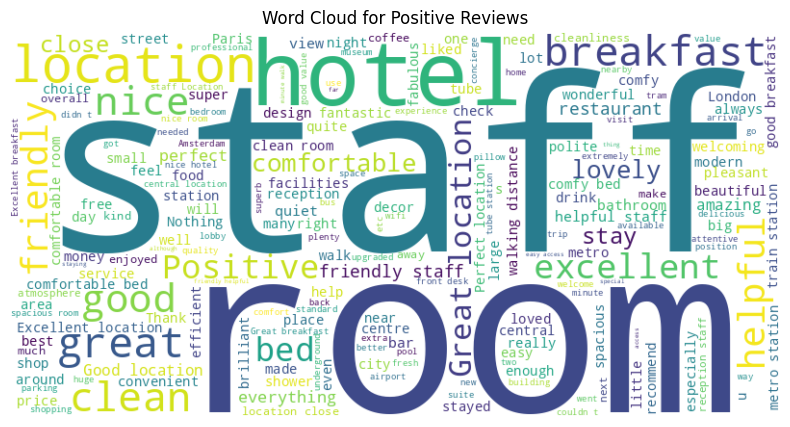

In [274]:
# plotting the graph
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.title('Word Cloud for Positive Reviews')
plt.axis('off')
plt.show()

We can see some of the most common words are great location, staff, positive, friendly, great, etc.

In [275]:
# for negative reviews
negative_reviews = " ".join(df['Negative_Review'].dropna())
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(negative_reviews)


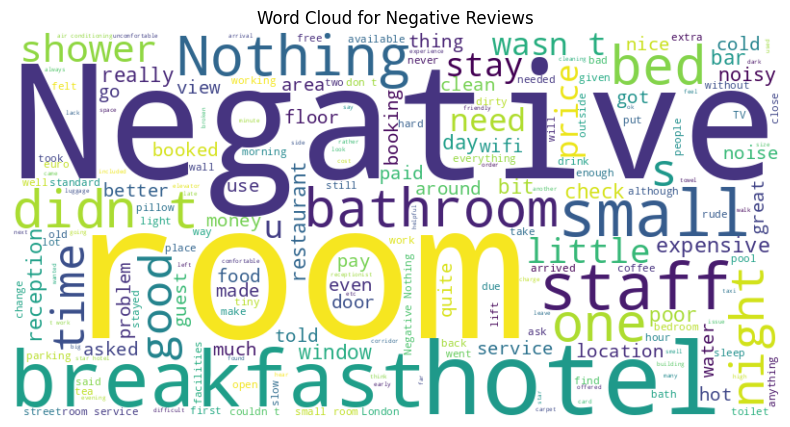

In [276]:
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.title('Word Cloud for Negative Reviews')
plt.axis('off')
plt.show()

We can see some of the most common words are negative, nothing, bathroom, small room, price, etc

Lets also visualize for the tags column

In [277]:
#tag analsis
tags_data = df['Tags']

# Concatenate all tags into a single string
all_tags = ' '.join(tags_data.dropna())

# Generate a word cloud
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(all_tags)

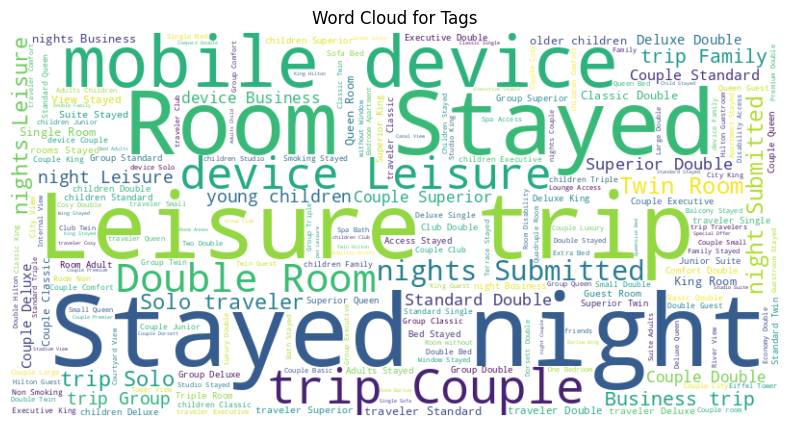

In [278]:
# Plot the word cloud
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.title('Word Cloud for Tags')
plt.axis('off')
plt.show()

We can see some of the most common words that occured in the tags column are leisure, trip couple, double room, etc.

# KMeans Clustering

In [279]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
import plotly.express as px

Since kmeans algorithm is for numeric values only let's subset the numeric features

In [280]:
# Separate numerical columns
numerical_columns = df.select_dtypes(include=['float64', 'int64']).columns

In [281]:
numeric_data= df[numerical_columns]
numeric_data.head()

,Additional_Number_of_Scoring,Average_Score,Review_Total_Negative_Word_Counts,Total_Number_of_Reviews,Review_Total_Positive_Word_Counts,Total_Number_of_Reviews_Reviewer_Has_Given,Reviewer_Score,days_since_review,lat,lng
300354,105,8.3,12,1382,3,1,6.7,376,41.400665,2.178709
102936,297,8.0,11,2868,13,7,9.2,163,48.864269,2.330818
22243,77,9.1,0,338,25,20,10.0,448,48.869910,2.297339
495111,108,8.5,61,2135,0,4,3.8,396,45.526640,9.213155
120420,918,8.4,0,4117,23,6,10.0,357,51.513930,-0.101126


In [282]:
numeric_data.shape

(10000, 10)

So we have 10 features for our kmeans clustering. Let's normalize the features

In [285]:
# Standardize the data
sc = StandardScaler()
normalized_data = sc.fit_transform(numeric_data)

In [286]:
df_normalized = pd.DataFrame(normalized_data, columns=numeric_data.columns)

In [287]:
df_normalized

,Additional_Number_of_Scoring,Average_Score,Review_Total_Negative_Word_Counts,Total_Number_of_Reviews,Review_Total_Positive_Word_Counts,Total_Number_of_Reviews_Reviewer_Has_Given,Reviewer_Score,days_since_review,lat,lng
0,-0.788441,-0.182246,-0.217136,-0.579573,-0.683599,-0.562120,-1.044888,0.095954,-2.295917,-0.139163
1,-0.404004,-0.726697,-0.248746,0.046717,-0.216545,-0.012611,0.496172,-0.917813,-0.155242,-0.105915
2,-0.844505,1.269624,-0.596453,-1.019577,0.343920,1.177991,0.989311,0.438636,-0.153624,-0.113233
3,-0.782434,0.180722,1.331739,-0.262213,-0.823715,-0.287366,-2.832516,0.191144,-1.112525,1.398420
4,0.839411,-0.000762,-0.596453,0.573120,0.250509,-0.104196,0.989311,0.005524,0.604722,-0.637487
...,...,...,...,...,...,...,...,...,...,...
9995,2.667491,-0.545214,0.920813,1.832443,-0.263250,-0.562120,-1.044888,0.148308,0.600453,-0.657286
9996,-0.223799,-0.545214,-0.533233,1.523934,-0.450072,-0.470535,-0.305179,-0.946369,-0.347333,2.956270
9997,-0.221796,-0.000762,-0.217136,-0.442177,0.016982,-0.104196,-0.058610,-1.046318,0.599228,-0.654244
9998,0.761322,0.725173,-0.343575,0.004571,-0.263250,-0.562120,-0.058610,0.172106,0.603122,-0.611036


Now lets find the optimal number of k for the clustering

In [288]:
pip install kneed

In [289]:
from kneed import KneeLocator

In [290]:
# find the optimal value of k
wcss = []

k_values = range(1, 11)

for i in k_values:
    kmeans = KMeans(n_clusters= i, init='random',  n_init= 'auto')
    kmeans.fit(df_normalized)
    wcss.append(kmeans.inertia_)

In [291]:
# Use KneeLocator to find the knee in the curve
knee_locator = KneeLocator(k_values, wcss, curve="convex", direction="decreasing")

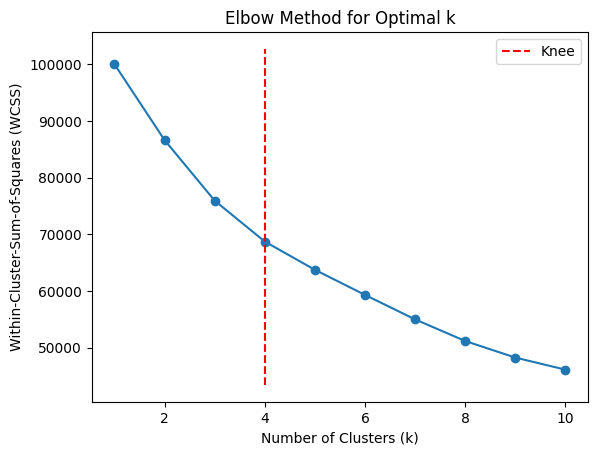

In [292]:
# elbow plot for best value of k
plt.plot(range(1, 11), wcss, marker='o')
plt.title('Elbow Method for Optimal k')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Within-Cluster-Sum-of-Squares (WCSS)')

# Mark the knee point
plt.vlines(knee_locator.knee, plt.ylim()[0], plt.ylim()[1], linestyles='dashed', colors='red', label='Knee')
plt.legend()

In [293]:
optimal_k = knee_locator.knee
print(f'Optimal Number of Clusters (k): {optimal_k}')

Optimal Number of Clusters (k): 4


Now, lets perform kmeans clustering with our optimal cluster number of 4

In [294]:
# Kmeans clustering
kmeans = KMeans(n_clusters = optimal_k, init='random',  n_init= 'auto')
df_normalized['Cluster'] = kmeans.fit_predict(df_normalized)

In [295]:
numeric_data['Cluster'] = df_normalized['Cluster'].values.copy()

<ipython-input-295-d54022ba891b>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [296]:
numeric_data.head()

,Additional_Number_of_Scoring,Average_Score,Review_Total_Negative_Word_Counts,Total_Number_of_Reviews,Review_Total_Positive_Word_Counts,Total_Number_of_Reviews_Reviewer_Has_Given,Reviewer_Score,days_since_review,lat,lng,Cluster
300354,105,8.3,12,1382,3,1,6.7,376,41.400665,2.178709,2
102936,297,8.0,11,2868,13,7,9.2,163,48.864269,2.330818,0
22243,77,9.1,0,338,25,20,10.0,448,48.869910,2.297339,0
495111,108,8.5,61,2135,0,4,3.8,396,45.526640,9.213155,1
120420,918,8.4,0,4117,23,6,10.0,357,51.513930,-0.101126,0


In [297]:
df_normalized.head()

,Additional_Number_of_Scoring,Average_Score,Review_Total_Negative_Word_Counts,Total_Number_of_Reviews,Review_Total_Positive_Word_Counts,Total_Number_of_Reviews_Reviewer_Has_Given,Reviewer_Score,days_since_review,lat,lng,Cluster
0,-0.788441,-0.182246,-0.217136,-0.579573,-0.683599,-0.562120,-1.044888,0.095954,-2.295917,-0.139163,2
1,-0.404004,-0.726697,-0.248746,0.046717,-0.216545,-0.012611,0.496172,-0.917813,-0.155242,-0.105915,0
2,-0.844505,1.269624,-0.596453,-1.019577,0.343920,1.177991,0.989311,0.438636,-0.153624,-0.113233,0
3,-0.782434,0.180722,1.331739,-0.262213,-0.823715,-0.287366,-2.832516,0.191144,-1.112525,1.398420,1
4,0.839411,-0.000762,-0.596453,0.573120,0.250509,-0.104196,0.989311,0.005524,0.604722,-0.637487,0


In [298]:
# Print the counts of each cluster
print(df_normalized['Cluster'].value_counts())


0    4467
2    2419
1    1929
3    1185
Name: Cluster, dtype: int64


From the output, we can see that the largest cluster, Cluster 0, contains 4501 data points, suggesting that a significant portion of the dataset exhibits characteristics or patterns that align with this particular cluster. Cluster 2 follows as the second-largest group with 2458 data points, while Clusters 1 and 3 are comparatively smaller with 1853 and 1188 data points, respectively.

In [299]:
import seaborn as sns

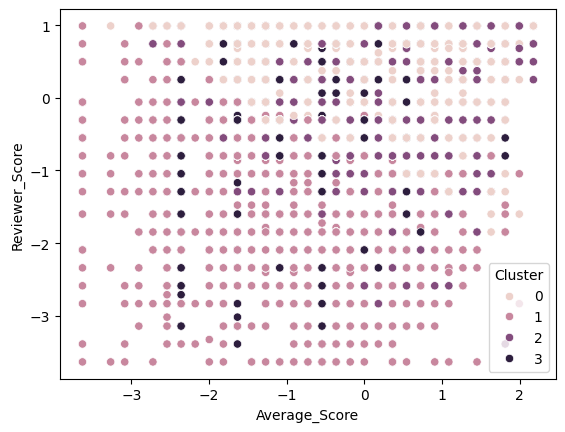

In [300]:
# 2D Plot
sns.scatterplot(data = df_normalized, x ='Average_Score', y = 'Reviewer_Score', hue = 'Cluster' )
plt.show()

We can see from the scatter plot that cluster 2 and cluster 3 are mostly located at the upper left traingle corner.
 Cluster 0 seems to be spread across a wide range of 'Average_Score' values but mostly concentrated in the middle range of 'Reviewer_Score'.
  Cluster 1 appears to be quite tight in both 'Average_Score' and 'Reviewer_Score' which suggests high similarity in the scores within this group.
  Cluster 2 is quite dispersed along the 'Average_Score' axis but relatively tight in 'Reviewer_Score'.
  Cluster 3 is the smallest and most tightly grouped, indicating that both the 'Average_Score' and 'Reviewer_Score' are very similar within this group.

Now, lets try to plot a map b taking the latitude longitude and keep the cluster label as icon.

In [301]:
import folium
from folium.plugins import MarkerCluster


# Create a Folium Map centered at the mean latitude and longitude
map_center = [numeric_data['lat'].mean(), numeric_data['lng'].mean()]
my_map = folium.Map(location=map_center, zoom_start=3)

# Create a MarkerCluster for better performance with a large number of points
marker_cluster = MarkerCluster().add_to(my_map)

for index, row in numeric_data.iterrows():
    popup_content = f"""
    <strong>Cluster:</strong> {row['Cluster']}<br>
    <strong>Latitude:</strong> {row['lat']:.6f}<br>
    <strong>Longitude:</strong> {row['lng']:.6f}<br>
    """
    folium.Marker(
        location=[row['lat'], row['lng']],
        popup=folium.Popup(popup_content, max_width=300),
        icon=folium.Icon(color=f'cluster_{int(row["Cluster"])}', prefix='fa', icon='map-marker')
    ).add_to(marker_cluster)

# Add a fullscreen option and a title
folium.plugins.Fullscreen().add_to(my_map)
folium.map.Marker(
    location=map_center,
    icon=folium.Icon(color='red', icon='info-sign'),
    popup=folium.Popup('<b>Map with Clusters</b>', max_width=300)
).add_to(my_map)

# Save the map as an HTML file
my_map.save("enhanced_world_map_with_clusters.html")
my_map

<ipython-input-301-06da10b71a51>:21: UserWarning:

color argument of Icon should be one of: {'black', 'darkblue', 'darkgreen', 'beige', 'purple', 'pink', 'blue', 'lightred', 'lightgray', 'gray', 'red', 'lightblue', 'white', 'darkred', 'darkpurple', 'orange', 'lightgreen', 'green', 'cadetblue'}.



From this graph, we can see the different hotels with respect to their latitude, longitude and also the cluster they are assiged to.

Visualization wrt Total_Number_of_Reviews, Review_Total_Positive_Word_Counts andReview_Total_Negative_Word_Counts' with the Cluster as hue

In [302]:
# Visualize the clusters in 3D using plotly
fig = px.scatter_3d(df_normalized, x = 'Total_Number_of_Reviews', y = 'Review_Total_Positive_Word_Counts', z = 'Review_Total_Negative_Word_Counts' , color='Cluster',
                    title='KMeans Clustering ')
fig.update_traces(marker_size = 3)
fig.show()

From the 3d graph we can see that cluster 1 and 3 has clear distinct boundaries and clearl can be spotted. But cluster 2 and cluster 3 are very mixed among each other. So, lets take another variables to plot our 3d graph and see the clusters formed.

Lets take the Average_Score, Total_Number_of_Reviews and Total_Number_of_Reviews_Reviewer_Has_Given as the variables this time.

In [303]:
# Visualize the clusters in 3D using plotly
fig = px.scatter_3d(df_normalized, x = 'Average_Score', y ='Total_Number_of_Reviews' , z = 'Total_Number_of_Reviews_Reviewer_Has_Given', color='Cluster',
                    title='KMeans Clustering ')
fig.update_traces(marker_size = 3)
fig.show()

Now, let us plot for Reviewer_Score,'Total_Number_of_Reviews' and Average_Score' and see the differnces in the cluster formed.

In [304]:
# Visualize the clusters in 3D using plotly
fig = px.scatter_3d(df_normalized, z = 'Reviewer_Score', x ='Total_Number_of_Reviews' , y = 'Average_Score', color='Cluster',
                    title='KMeans Clustering ')
fig.update_traces(marker_size = 3)
fig.show()

We can see from the 3d graph, that cluster 3 and cluster 1 are very nicely separated but we cant say the same for the clusters 0 ansd 2.

In [305]:
# Visualize the clusters in 3D using plotly
fig = px.scatter_3d(df_normalized, y = 'Review_Total_Negative_Word_Counts', z = 'Review_Total_Positive_Word_Counts', x= 'Average_Score', color='Cluster',
                    title='KMeans Clustering ')
fig.update_traces(marker_size = 3)
fig.show()

From the 3d graph, we can see that most of the points are located at the edge of the grid. We can see most of the outliers as well. Most of the outliers lies falls in cluster 1.

In [306]:
inertia = kmeans.inertia_
print(f"Inertia: {inertia}")


Inertia: 68711.60622036879


#**Kmeans++ clustering**

Now,  lets try another algorithm to ensure a smarter initialization of the centroids and improves the quality of the clustering. Let' try kmeans++.

In [307]:
# drop the cluster label from previous clustering
df_normalized.drop(['Cluster'], axis = 1 )

,Additional_Number_of_Scoring,Average_Score,Review_Total_Negative_Word_Counts,Total_Number_of_Reviews,Review_Total_Positive_Word_Counts,Total_Number_of_Reviews_Reviewer_Has_Given,Reviewer_Score,days_since_review,lat,lng
0,-0.788441,-0.182246,-0.217136,-0.579573,-0.683599,-0.562120,-1.044888,0.095954,-2.295917,-0.139163
1,-0.404004,-0.726697,-0.248746,0.046717,-0.216545,-0.012611,0.496172,-0.917813,-0.155242,-0.105915
2,-0.844505,1.269624,-0.596453,-1.019577,0.343920,1.177991,0.989311,0.438636,-0.153624,-0.113233
3,-0.782434,0.180722,1.331739,-0.262213,-0.823715,-0.287366,-2.832516,0.191144,-1.112525,1.398420
4,0.839411,-0.000762,-0.596453,0.573120,0.250509,-0.104196,0.989311,0.005524,0.604722,-0.637487
...,...,...,...,...,...,...,...,...,...,...
9995,2.667491,-0.545214,0.920813,1.832443,-0.263250,-0.562120,-1.044888,0.148308,0.600453,-0.657286
9996,-0.223799,-0.545214,-0.533233,1.523934,-0.450072,-0.470535,-0.305179,-0.946369,-0.347333,2.956270
9997,-0.221796,-0.000762,-0.217136,-0.442177,0.016982,-0.104196,-0.058610,-1.046318,0.599228,-0.654244
9998,0.761322,0.725173,-0.343575,0.004571,-0.263250,-0.562120,-0.058610,0.172106,0.603122,-0.611036


In [308]:
df_normalized.head()

,Additional_Number_of_Scoring,Average_Score,Review_Total_Negative_Word_Counts,Total_Number_of_Reviews,Review_Total_Positive_Word_Counts,Total_Number_of_Reviews_Reviewer_Has_Given,Reviewer_Score,days_since_review,lat,lng,Cluster
0,-0.788441,-0.182246,-0.217136,-0.579573,-0.683599,-0.562120,-1.044888,0.095954,-2.295917,-0.139163,2
1,-0.404004,-0.726697,-0.248746,0.046717,-0.216545,-0.012611,0.496172,-0.917813,-0.155242,-0.105915,0
2,-0.844505,1.269624,-0.596453,-1.019577,0.343920,1.177991,0.989311,0.438636,-0.153624,-0.113233,0
3,-0.782434,0.180722,1.331739,-0.262213,-0.823715,-0.287366,-2.832516,0.191144,-1.112525,1.398420,1
4,0.839411,-0.000762,-0.596453,0.573120,0.250509,-0.104196,0.989311,0.005524,0.604722,-0.637487,0


Now, let us use the elbow method to find the optimal value of k

In [309]:
# find the optimal value of k
wcss = []

k_values = range(1, 11)

for i in k_values:
    kmeansplusplus = KMeans(n_clusters= i, init='k-means++', n_init= 'auto' )
    kmeansplusplus.fit(df_normalized)
    wcss.append(kmeansplusplus.inertia_)

In [310]:
# Use KneeLocator to find the knee in the curve
knee_locator = KneeLocator(k_values, wcss, curve="convex", direction="decreasing")

In [311]:
optimal_k = knee_locator.knee
print(f'Optimal Number of Clusters (k): {optimal_k}')

Optimal Number of Clusters (k): 4


We can see that the optimal  value is 5, Now lets proceed with the clustering.

In [312]:
# Apply KMeans++ clustering
kmeans_plusplus = KMeans(n_clusters = optimal_k, init='k-means++', random_state=42, n_init= 'auto')
df_normalized['Cluster'] = kmeans_plusplus.fit_predict(df_normalized)


In [313]:
# Print the counts of each cluster
print(df_normalized['Cluster'].value_counts())


0    4467
3    2419
1    1929
2    1185
Name: Cluster, dtype: int64


We can see this time also the cluster points are unevenly assigned to different clusters.

In [314]:
# Visualize the clusters in 3D using plotly
fig = px.scatter_3d(df_normalized, x = 'Average_Score', y ='Review_Total_Negative_Word_Counts' , z = 'Review_Total_Positive_Word_Counts', color='Cluster',
                    title='KMeans Plus Plus Clustering ')
fig.update_traces(marker_size = 3)
fig.show()

This is the result of the clustering we did based on Average_Score','Review_Total_Negative_Word_Counts'
 and 'Review_Total_Positive_Word_Counts. We can see for cluster 2 which has the most number of outliers has higher Review_Total_Negative_Word_Counts in common.

Now we will try another clustering method and see how the results differ. Let's try hierarchical clustering.

#**Hierarchical Clustering**

In [315]:
from scipy.cluster.hierarchy import linkage, fcluster

In [316]:
df_normalized.drop(['Cluster'], axis = 1, inplace = True )

In [317]:
Z3 = linkage(df_normalized, 'ward')
df_normalized['cluster_labels'] = fcluster(Z3,t= 4 ,criterion='maxclust')

In [318]:
df_normalized['cluster_labels'].value_counts()

4    3876
1    2397
2    2068
3    1659
Name: cluster_labels, dtype: int64

We can see from the cluster labels count that cluster 4 has highest number of points and cluster 2 has the lowest which is different from what we obtained from the last two clustering algorithms.

Now let us do a pairplot for the latitude, longitude and average score columns wrt to the different cluster labels.

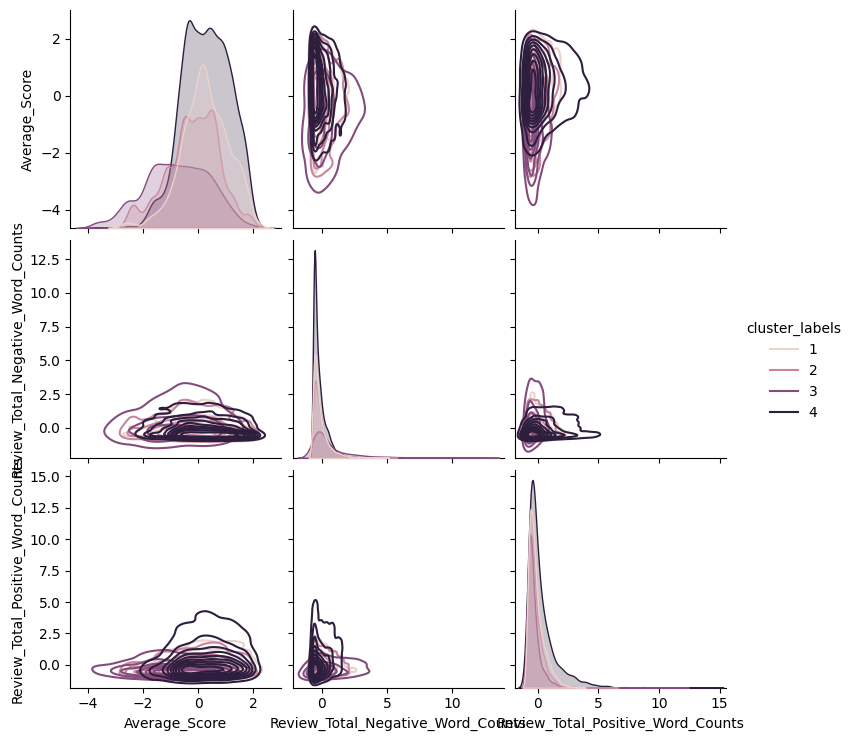

In [319]:
sns.pairplot(df_normalized[['Average_Score','Review_Total_Negative_Word_Counts' , 'Review_Total_Positive_Word_Counts', 'cluster_labels']], hue="cluster_labels", kind='kde')

In [320]:
# Visualize the clusters in 3D using plotly
fig = px.scatter_3d(df_normalized, x = 'Average_Score', y ='Review_Total_Negative_Word_Counts' , z = 'Review_Total_Positive_Word_Counts', color='cluster_labels',
                    title='Hierarchical Clustering')
fig.update_traces(marker_size = 3)
fig.show()

#**DBSCAN Clustering**

Now let's use a last clustering algorithm, DBSCAN. As most of the points are super close to one another. So DBSCAn will help to separate high density clusters from low densit clusters.

In [321]:
from sklearn.cluster import DBSCAN

In [322]:
df_normalized.drop(['cluster_labels'], axis = 1, inplace = True  )

In [323]:
dbscan = DBSCAN(eps=0.5, min_samples= 8)
df_normalized['Cluster_DBSCAN'] = dbscan.fit_predict(df_normalized)


In [324]:
df_normalized['Cluster_DBSCAN'].value_counts()

-1     9724
 0      124
 1       33
 5       32
 4       12
 12      10
 6        9
 8        9
 11       8
 9        8
 2        8
 7        8
 10       8
 3        7
Name: Cluster_DBSCAN, dtype: int64

We can see how cluster -1 has most of the data points and other clusters have very few data points. So, the 3d graph will be dominated by just one color.

In [325]:
# Visualize the clusters in 3D using plotly
fig = px.scatter_3d(df_normalized, x = 'Average_Score', y ='Review_Total_Negative_Word_Counts' , z = 'Review_Total_Positive_Word_Counts', color='Cluster_DBSCAN',
                    title='DBSCAN Clustering')
fig.update_traces(marker_size = 3)
fig.show()

#**PCA**

Now, let us try dimensionality reduction using PCA.

In [326]:
df_normalized.drop(['Cluster_DBSCAN'], axis = 1 , inplace = True)

In [327]:
from sklearn.decomposition import PCA

In [328]:
pca = PCA()
pca.fit(df_normalized)
pca.components_.shape


(10, 10)

In [329]:
df_components = pd.DataFrame(pca.components_, columns = df_normalized.columns)

In [330]:
df_components

,Additional_Number_of_Scoring,Average_Score,Review_Total_Negative_Word_Counts,Total_Number_of_Reviews,Review_Total_Positive_Word_Counts,Total_Number_of_Reviews_Reviewer_Has_Given,Reviewer_Score,days_since_review,lat,lng
0,0.593055,-0.306890,0.135587,0.509251,-0.112412,-0.091146,-0.227357,0.003525,0.342315,-0.294206
1,-0.289512,-0.398851,0.469610,-0.236672,-0.208821,0.054506,-0.645281,-0.020608,-0.104944,0.078426
2,0.184392,0.030146,0.087860,0.485963,0.078414,0.387742,-0.063620,0.038073,-0.451464,0.596157
3,0.025266,0.134879,0.526684,-0.014497,0.724296,0.019329,0.047970,-0.399800,0.096235,-0.084750
4,-0.012209,0.045518,0.148585,-0.115259,0.208399,0.555938,0.022490,0.718400,0.257993,-0.163569
5,-0.024945,-0.052265,-0.218648,-0.077949,-0.208809,0.715544,0.007422,-0.566758,0.224165,-0.125057
6,-0.111612,-0.791432,-0.371383,-0.012542,0.439983,0.001000,0.147346,0.025767,-0.075501,0.037879
7,0.069563,0.019015,0.015052,0.037230,0.000918,0.125178,-0.001711,0.008400,-0.717234,-0.680455
8,-0.036248,-0.303871,0.517616,0.001305,-0.363732,0.028764,0.709433,-0.009313,-0.028951,0.032742
9,-0.714457,0.061382,0.001870,0.653739,-0.009302,-0.020901,-0.001788,0.011742,0.144754,-0.191801


We have 10 features so let us see the PCA for all the 10 features.

In [331]:
var_ratio = pca.explained_variance_ratio_
var_df = pd.DataFrame(var_ratio, columns=['Explained Variance Ratio'], index=['PC1', 'PC2', 'PC3', 'PC4', 'PC5', 'PC6', 'PC7', 'PC8', 'PC9', 'PC10'])
print(var_df)


      Explained Variance Ratio
PC1                   0.215506
PC2                   0.151533
PC3                   0.121490
PC4                   0.115150
PC5                   0.099765
PC6                   0.092774
PC7                   0.077582
PC8                   0.068476
PC9                   0.046229
PC10                  0.011494


Let us do a scree plot to see how many features we need to capture 85% variance of the dataset.

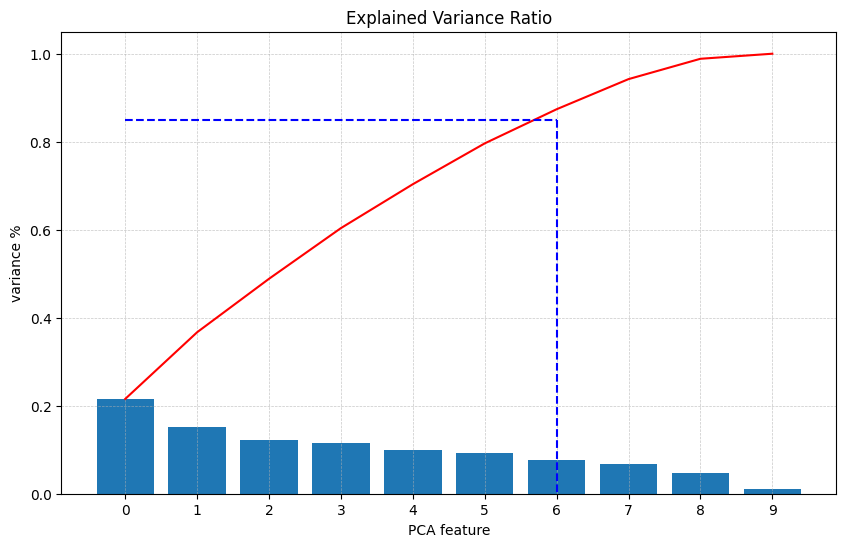

In [332]:
component_ids = range(pca.n_components_)

plt.figure(figsize=(10, 6))
plt.bar(component_ids, pca.explained_variance_ratio_)
plt.plot(component_ids, np.cumsum(pca.explained_variance_ratio_), color='red')
plt.xticks(component_ids)
plt.ylabel('variance %')
plt.xlabel('PCA feature')
plt.grid()
#find the coordinates where the variance is >85%
cross_idx = np.argmax(np.cumsum(pca.explained_variance_ratio_) > 0.85)

#getting the 85% variance lines
plt.hlines(y=0.85, xmin=0, xmax=cross_idx, color='blue', linestyle='dashed')

# Plotting vertical line down to x-axis
plt.vlines(x=cross_idx, ymin=0.85, ymax=0, color='blue', linestyle='dashed')

plt.title('Explained Variance Ratio')
plt.grid(linestyle = '--', linewidth = 0.5, alpha = 0.7)

plt.show()




In [333]:
fig = px.line(pd.DataFrame(np.cumsum(pca.explained_variance_ratio_)))
fig.show()

So, from all the plotted graphs we can see that 6 features captures 85% of the variance for the dataset.<br>
Now, let us plot the top 3 PCAs.

In [334]:
df_numeric_corrected_transformed_3D = pd.DataFrame(pca.transform(df_normalized)[:, 0:3], columns=['PC1', 'PC2', 'PC3'])

fig = px.scatter_3d(df_numeric_corrected_transformed_3D, x='PC1', y='PC2', z='PC3',)
fig.update_traces(marker_size = 3)
fig.show()